## Fit a "Regional Grain Size Model" to NI and Mass and E  Australia samples

Daniel Buscombe, Sept 2022

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn import ensemble
from sklearn.metrics import mean_squared_error
from sklearn.inspection import permutation_importance

from pingouin import partial_corr
import pingouin as pg
from sklearn.model_selection import RepeatedKFold, cross_val_score
import seaborn as sns
from sklearn import preprocessing
from sklearn.model_selection import GridSearchCV

import geopandas as gpd
from geopandas.tools import sjoin

In [2]:
# do_gs_strat = True

In [3]:
dfNI = pd.read_csv('../model_data/dataset_NI_strat_gs.csv')
dfMass = pd.read_csv('../model_data/dataset_Mass_strat_gs.csv')
dfMass = dfMass[dfMass['d50']<=2.0]

dfMass['code'] = np.ones(len(dfMass))
dfNI['code'] = np.zeros(len(dfNI))

dfNI = dfNI[['latitude', 'longitude', 'd50', 'beach_slope_average', 'mstr','code',
       'hs_mean']]

dfMass = dfMass[['latitude', 'longitude', 'd50', 'beach_slope_average', 'mstr', 'code',
       'hs_mean']]

In [4]:
# dfNI

In [5]:
# dfMass

In [6]:
dfEAus = pd.read_csv('../model_data/dataset_E_Aus_coast_strat_gs.csv')
dfEAus['code'] = np.ones(len(dfEAus))*2
dfEAus = dfEAus[['latitude', 'longitude', 'd50', 'beach_slope_average', 'mstr', 'code',
       'hs_mean']]

In [7]:
dfEAus

,latitude,longitude,d50,beach_slope_average,mstr,code,hs_mean
0,-31.432239,152.924106,0.20390,0.050000,1.858446,2.0,1.558088
1,-31.464647,152.934799,0.20980,0.061327,1.858446,2.0,1.558088
2,-28.462367,153.556383,0.23370,0.047159,1.942736,2.0,1.040591
3,-29.586907,153.332986,0.19120,0.055068,1.923244,2.0,1.588566
4,-34.621103,150.857254,0.20730,0.052926,1.703965,2.0,1.666609
...,...,...,...,...,...,...,...
235,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618
236,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618
237,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618
238,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618


In [8]:
df = pd.concat([dfNI, dfMass, dfEAus], ignore_index=True)
df = df.dropna()

In [9]:
rand = np.random.randn(len(df))
len(df)

416

In [10]:
df

,latitude,longitude,d50,beach_slope_average,mstr,code,hs_mean
0,54.607820,-5.528463,0.14100,0.018300,3.500000,0.0,1.380000
1,54.703803,-6.363024,0.21400,0.016100,4.000000,0.0,1.530000
2,55.182910,-6.718701,0.15700,0.024600,1.500000,0.0,2.260000
3,54.250000,-5.766667,0.13700,0.008800,5.000000,0.0,1.380000
4,54.436630,-5.468761,0.17000,0.028000,3.600000,0.0,1.550000
...,...,...,...,...,...,...,...
411,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618
412,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618
413,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618
414,-26.597765,153.100290,0.95264,0.060769,2.036081,2.0,1.498618


In [11]:
sum(df['code']==1.0)

76

In [12]:
sum(df['code']==0.0)

100

In [13]:
sum(df['code']==2.0)

240

In [14]:
parameters = {
    'n_estimators':[25,50, 100,200,300, 500], 
    'max_depth':[3,5,7,9,11], 
    "min_samples_split":[3,5,7,9,11], 
    "learning_rate": [0.01,0.05, 0.075, 0.1], 
    "subsample": [0.25,0.5,0.75,1.0],
    "loss": ["squared_error", "absolute_error", "huber"]
}

##27 individual parameter settings

In [15]:
Smean = []
Sstd = []

test_size = 0.6

standardize = False

### model 1

In [16]:
feature_names1 = ['β (radians)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')
    
X_train1, X_test1, y_train1, y_test1 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test1.max())
print(y_train1.max())

# model1 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model1 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model1.fit(X_train1, y_train1)

mse1 = mean_squared_error(y_test1, model1.predict(X_test1))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse1))

print(model1.best_params_)

model1out = {}
model1out['feature_names'] = feature_names1
model1out['Xtest'] = X_test1
model1out['Xtrain'] = X_train1
model1out['ytest'] = y_test1
model1out['ytrain'] = y_train1
model1out['model'] = model1
model1out['mse'] = mse1
model1out['best_params'] = model1.best_params_

model1 = model1.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model1, X_test1, y_test1, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.370240964
1.370240964
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.2s[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_e

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=square

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_err


[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolut

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; to

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; t

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   9.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  11.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   7.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  13.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  10.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  15.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   9.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  15.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  17.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsam

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsam

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_e

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=sq

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_es

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; to

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; to

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  12.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  12.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.2

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  10.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  10.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  12.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimat

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  15.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsamp

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_er

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_e

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.7s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.2

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0;

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.2

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   9.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, s

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, 

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, sub

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_e

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolut

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samp

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; t

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; tot

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   8.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; tot

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  10.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; to

Mean RMSE: 0.142 (0.048)


### model 2

In [17]:
feature_names2 = [r'MSTR (m)', 'Random\n (non-dim.)']
X = np.stack((df['mstr'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')
    
X_train2, X_test2, y_train2, y_test2 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test2.max())
print(y_train2.max())

# model2 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model2 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model2.fit(X_train2, y_train2)

mse2 = mean_squared_error(y_test2, model2.predict(X_test2))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse2))

print(model2.best_params_)
model2out = {}
model2out['feature_names'] = feature_names2
model2out['Xtest'] = X_test2
model2out['Xtrain'] = X_train2
model2out['ytest'] = y_test2
model2out['ytrain'] = y_train2
model2out['model'] = model2
model2out['mse'] = mse2
model2out['best_params'] = model2.best_params_

model2 = model2.best_estimator_

cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model2, X_test2, y_test2, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.370240964
1.370240964
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25;

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; to

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squa

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_er


[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.3s[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; to

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsam

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; to

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsa

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  14.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; to

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  11.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; t

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  10.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsam

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_esti

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_erro

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_erro

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squ

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squa

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.05, loss=ab

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=ab

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=ab

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsamp

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsamp

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; t

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsa

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total ti

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsa

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total ti

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  10.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   9.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, m

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=s

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_er

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75;

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25;

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=30

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samp

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, ma

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.1, loss=absolute_e

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  10.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  11.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75;

The mean squared error (MSE) on test set: 0.0305
{'learning_rate': 0.075, 'loss': 'absolute_error', 'max_depth': 5, 'min_samples_split': 7, 'n_estimators': 300, 'subsample': 1.0}
Mean RMSE: 0.161 (0.057)


### model 3

In [18]:
feature_names3 = ['β (radians)','MSTR (m)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], df['mstr'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')


X_train3, X_test3, y_train3, y_test3 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test3.max())
print(y_train3.max())

# model3 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model3 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model3.fit(X_train3, y_train3)

mse3 = mean_squared_error(y_test3, model3.predict(X_test3))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse3))

print(model3.best_params_)
model3out = {}
model3out['feature_names'] = feature_names3
model3out['Xtest'] = X_test3
model3out['Xtrain'] = X_train3
model3out['ytest'] = y_test3
model3out['ytrain'] = y_train3
model3out['model'] = model3
model3out['mse'] = mse3
model3out['best_params'] = model3.best_params_

model3 = model3.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model3, X_test3, y_test3, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.370240964
1.370240964
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; 

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; t

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5;

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.1s[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error,


[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total ti

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; t

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; t

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   9.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   8.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; to

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  10.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  14.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; t

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  11.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  14.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  10.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsamp

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squa

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_e


[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=ab

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.05, loss=ab

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.7

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsamp

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   8.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total ti

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samp

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, m


[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_e

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.07

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075,

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  11.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   6.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  12.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, su

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estima

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_s

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_d


[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, ma

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, ma

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; to

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; tot

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   8.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; to

Mean RMSE: 0.129 (0.043)


### model 4

### model 5

In [19]:
feature_names5 = ['β (radians)','MSTR (m)',r'$H_s$ (m)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], df['mstr'], df['hs_mean'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')

X_train5, X_test5, y_train5, y_test5 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test5.max())
print(y_train5.max())

# model5 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model5 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model5.fit(X_train5, y_train5)

mse5 = mean_squared_error(y_test5, model5.predict(X_test5))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse5))

print(model5.best_params_)
model5out = {}
model5out['feature_names'] = feature_names5
model5out['Xtest'] = X_test5
model5out['Xtrain'] = X_train5
model5out['ytest'] = y_test5
model5out['ytrain'] = y_train5
model5out['model'] = model5
model5out['mse'] = mse5
model5out['best_params'] = model5.best_params_

model5 = model5.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model5, X_test5, y_test5, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.370240964
1.370240964
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.8s
[CV] END learning_

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75;

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total ti

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsamp

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.01, l

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsa

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   9.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   9.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  11.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.2

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsampl

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsam

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, sub

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_es

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75;

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; tot

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; tot

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; tot

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; to

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   9.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.7

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   8.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   9.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.7s[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   9.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_es

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=s

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=s

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, sub

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, s

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsam


[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, 

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.7

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, s

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, 

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_s

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,


[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolu

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=abs

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total ti


[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   9.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; t

The mean squared error (MSE) on test set: 0.0220
{'learning_rate': 0.1, 'loss': 'huber', 'max_depth': 7, 'min_samples_split': 9, 'n_estimators': 100, 'subsample': 0.25}
Mean RMSE: 0.130 (0.039)


### model 6

### model 7

### model 8

### plots

In [20]:
def prc_err(y,yest):
    return 100*(np.abs(y-yest)/y)

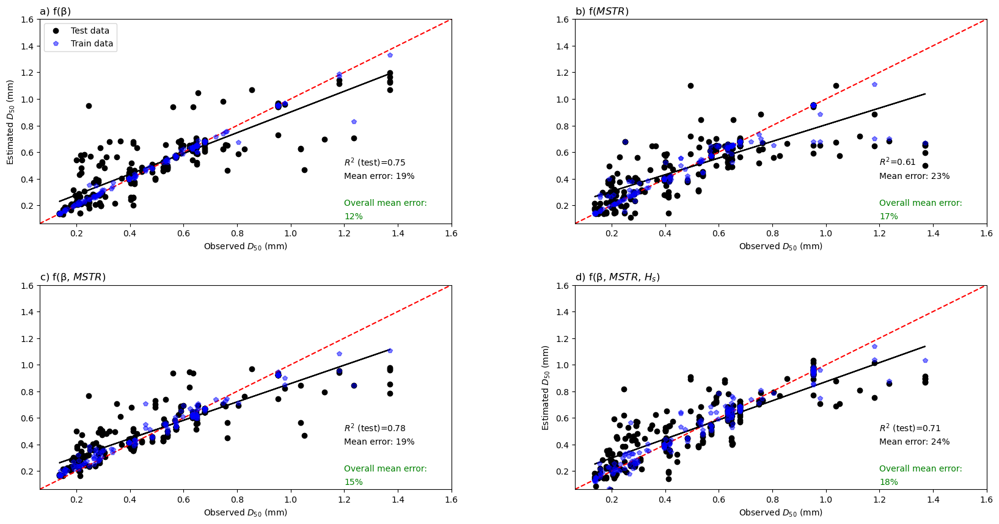

In [21]:
plt.figure(figsize=(20,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

plt.subplot(221)
ds_est = model1.predict(X_test1)
plt.plot(y_test1, ds_est, 'ko', label='Test data')
plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"a) f(β)", loc='left')
r2 = np.min(np.corrcoef(y_test1, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test1, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test1, poly1d_fn(y_test1), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1,ds_est)))[:2]))

ds_est2 = model1.predict(X_train1)
plt.plot(y_train1, ds_est2, 'bp', alpha=0.5, label='Train data')
plt.legend(loc=0)

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test1,y_train1)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(222)
ds_est = model2.predict(X_test2)
plt.plot(y_test2, ds_est, 'ko')
plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.title(r"b) f($MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test2, ds_est))**2
plt.text(1.2,.5,r'$R^2$='+str(r2)[:4])

coef = np.polyfit(y_test2, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test2, poly1d_fn(y_test2), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2,ds_est)))[:2]))

ds_est2 = model2.predict(X_train2)
plt.plot(y_train2, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test2,y_train2)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(223)
ds_est = model3.predict(X_test3)
plt.plot(y_test3, ds_est, 'ko')
plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.title("c) f(β, $MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test3, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test3, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test3, poly1d_fn(y_test3), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3,ds_est)))[:2]))

ds_est2 = model3.predict(X_train3)
plt.plot(y_train3, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test3,y_train3)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(224)
ds_est = model5.predict(X_test5)
plt.plot(y_test5, ds_est, 'ko')
plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"d) f(β, $MSTR$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test5, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test5, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test5, poly1d_fn(y_test5), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5,ds_est)))[:2]))

ds_est2 = model5.predict(X_train5)
plt.plot(y_train5, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test5,y_train5)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')


# plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-skill-FINAL.jpg', dpi=300, bbox_inches='tight')
plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-skill-FINAL2.jpg', dpi=300, bbox_inches='tight')


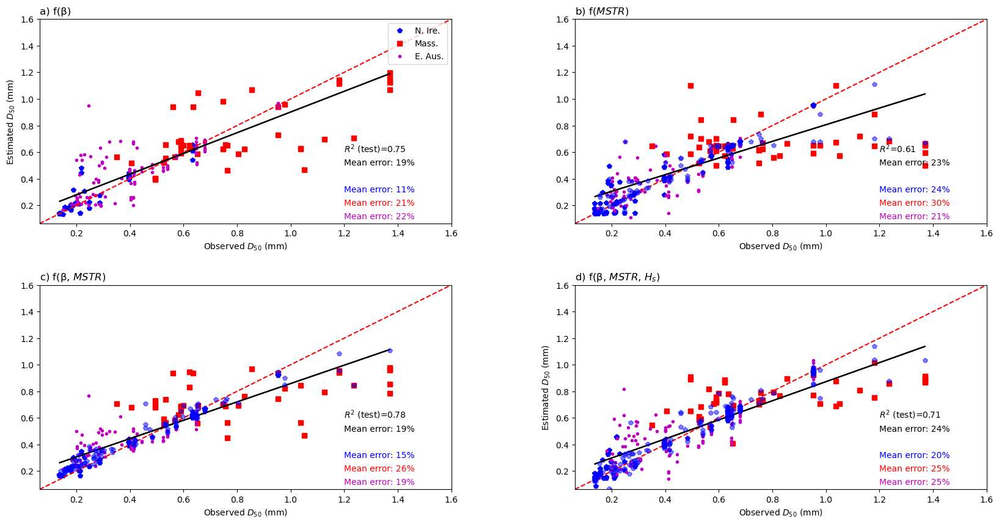

In [22]:
plt.figure(figsize=(20,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

C = np.stack((df['code']))
C_train1, C_test1, _, _ = train_test_split(
    C.T, df['d50'], test_size=test_size, random_state=2022
)

plt.subplot(221)
ds_est = model1.predict(X_test1)
plt.plot(y_test1[C_test1==0], ds_est[C_test1==0], 'bp', label='N. Ire.')
plt.plot(y_test1[C_test1==1], ds_est[C_test1==1], 'rs', label='Mass.')
plt.plot(y_test1[C_test1==2], ds_est[C_test1==2], 'm.', label='E. Aus.')


plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"a) f(β)", loc='left')
r2 = np.min(np.corrcoef(y_test1, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test1, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test1, poly1d_fn(y_test1), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1,ds_est)))[:2]))

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')

plt.legend(loc=1)

plt.subplot(222)
ds_est = model2.predict(X_test2)
plt.plot(y_test2[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test2[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test2[C_test1==2], ds_est[C_test1==2], 'm.', label='E. Aus.')

plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.title(r"b) f($MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test2, ds_est))**2
plt.text(1.2,.6,r'$R^2$='+str(r2)[:4])

coef = np.polyfit(y_test2, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test2, poly1d_fn(y_test2), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2,ds_est)))[:2]))
# plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[1])[:4]))

ds_est2 = model2.predict(X_train2)
plt.plot(y_train2, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')


plt.subplot(223)
ds_est = model3.predict(X_test3)
plt.plot(y_test3[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test3[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test3[C_test1==2], ds_est[C_test1==2], 'm.', label='E. Aus.')

plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.title("c) f(β, $MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test3, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test3, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test3, poly1d_fn(y_test3), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3,ds_est)))[:2]))

ds_est2 = model3.predict(X_train3)
plt.plot(y_train3, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')


plt.subplot(224)
ds_est = model5.predict(X_test5)
plt.plot(y_test5[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test5[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test5[C_test1==2], ds_est[C_test1==2], 'm.', label='E. Aus.')

plt.xlim(0.063,1.6); plt.ylim(0.063,1.6)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"d) f(β, $MSTR$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test5, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test5, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test5, poly1d_fn(y_test5), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5,ds_est)))[:2]))

ds_est2 = model5.predict(X_train5)
plt.plot(y_train5, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')


# plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-skill-by-dataset-FINAL.jpg', dpi=300, bbox_inches='tight')
plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-skill-by-dataset-FINAL2.jpg', dpi=300, bbox_inches='tight')



In [23]:
# X = np.stack((df['beach_slope_average'], df['mstr'], df['tp'], df['hs_mean'],  rand))
# ds_est8 = model8.predict(X.T)

# X = np.stack((df['beach_slope_average'], df['mstr'], df['tp'], rand))
# ds_est4 = model4.predict(X.T)

In [ ]:
# plt.figure(figsize=(10,10))
# plt.subplots_adjust(wspace=0.3, hspace=0.3)

# plt.subplot(221)
# plt.stem(df['d50'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
# plt.stem(df['d50'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
# plt.legend()
# plt.ylabel(r'Model residuals')
# plt.xlabel(r'$D_{50}$ (mm)')
# plt.title(r"a) ", loc='left')

# plt.subplot(222)
# plt.stem(df['hs_mean'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
# plt.stem(df['hs_mean'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
# plt.legend()
# plt.ylabel(r'Model residuals')
# plt.xlabel(r'$H_s$ (m)')
# plt.title(r"b) ", loc='left')

# plt.subplot(223)
# plt.stem(df['tp'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
# plt.stem(df['tp'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
# plt.legend()
# plt.ylabel(r'Model residuals')
# plt.xlabel(r'$T_p$ (m)')
# plt.title(r"c) ", loc='left')

# plt.subplot(224)
# plt.stem(df['mstr'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
# plt.stem(df['mstr'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
# plt.legend()
# plt.ylabel(r'Model residuals')
# plt.xlabel(r'$MSTR$ (m)')
# plt.title(r"d) ", loc='left')

# plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-model8_residuals-skill-FINAL.jpg', dpi=300, bbox_inches='tight')

/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)


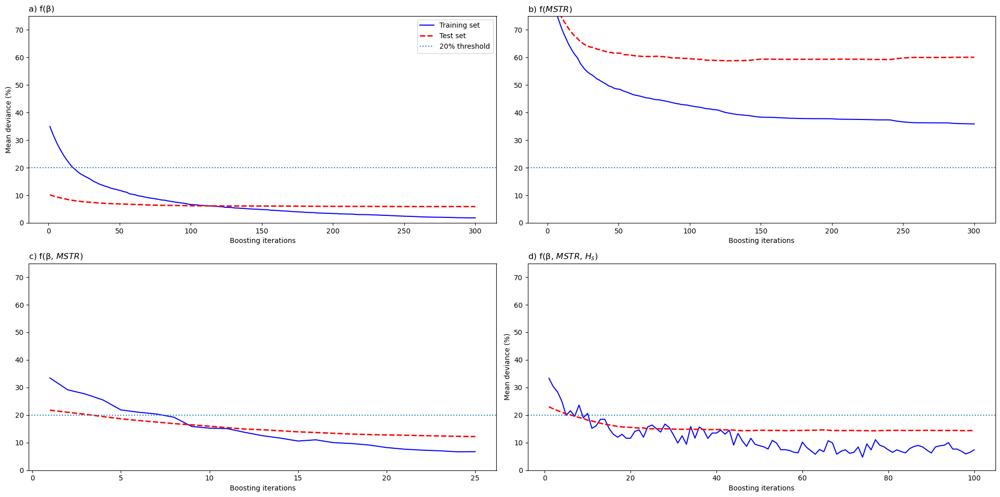

In [24]:
mm = df['d50'].mean()


fig=plt.figure(figsize=(20,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

####################
test_score = np.zeros((model1.n_estimators,), dtype=np.float64)
for i, y_pred1 in enumerate(model1.staged_predict(X_test1)):
    test_score[i] = model1.loss_(y_test1, y_pred1)

plt.subplot(2, 2, 1)
plt.title(r"a) f(β)", loc='left')
plt.plot(
    np.arange(model1.n_estimators) + 1,
    100*(np.sqrt(model1.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model1.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
plt.ylabel("Mean deviance (%)")
plt.ylim(0,75)
plt.legend(loc=0)

###########################
test_score = np.zeros((model2.n_estimators,), dtype=np.float64)
for i, y_pred2 in enumerate(model2.staged_predict(X_test2)):
    test_score[i] = model2.loss_(y_test2, y_pred2)

plt.subplot(2,2, 2)
plt.title(r"b) f($MSTR$)", loc='left')
plt.plot(
    np.arange(model2.n_estimators) + 1,
    100*(np.sqrt(model2.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model2.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)

#############################
test_score = np.zeros((model3.n_estimators,), dtype=np.float64)
for i, y_pred3 in enumerate(model3.staged_predict(X_test3)):
    test_score[i] = model3.loss_(y_test3, y_pred3)

plt.subplot(2,2, 3)
plt.title("c) f(β, $MSTR$)", loc='left')
plt.plot(
    np.arange(model3.n_estimators) + 1,
    100*(np.sqrt(model3.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model3.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)


#####################
test_score = np.zeros((model5.n_estimators,), dtype=np.float64)
for i, y_pred5 in enumerate(model5.staged_predict(X_test5)):
    test_score[i] = model5.loss_(y_test5, y_pred5)
    
plt.subplot(2,2,4)
plt.title(r"d) f(β, $MSTR$, $H_s$) ", loc='left')
plt.plot(
    np.arange(model5.n_estimators) + 1,
    100*(np.sqrt(model5.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model5.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
plt.ylabel("Mean deviance (%)")
plt.ylim(0,75)


fig.tight_layout()
# plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-training-FINAL.jpg', dpi=300, bbox_inches='tight')
plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-training-FINAL2.jpg', dpi=300, bbox_inches='tight')

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; tota

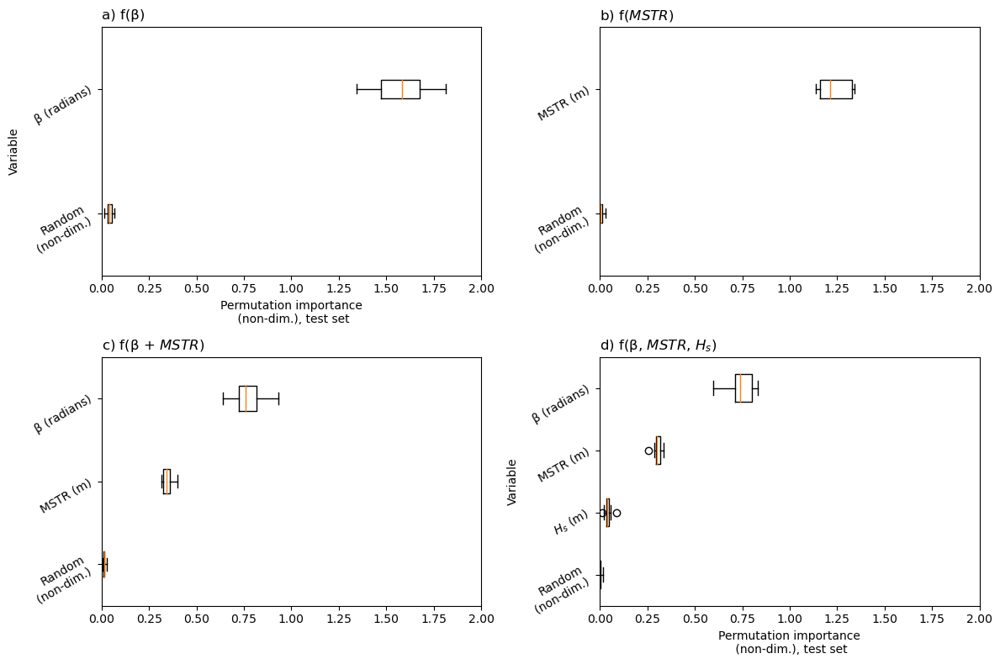

In [25]:

fig=plt.figure(figsize=(12,8))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

########################
result = permutation_importance(
    model1, X_test1, y_test1, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(221)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names1)[sorted_idx],
)

plt.xlim(0,2)
plt.title("a) f(β) ", loc='left')
plt.xlabel("Permutation importance\n (non-dim.), test set")
plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

#########################
result = permutation_importance(
    model2, X_test2, y_test2, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(222)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names2)[sorted_idx],
)

plt.xlim(0,2)
plt.title("b) f($MSTR$) ", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

#############################
result = permutation_importance(
    model3, X_test3, y_test3, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(223)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names3)[sorted_idx],
)

plt.xlim(0,2)
plt.title("c) f(β + $MSTR$) ", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)


############################
result = permutation_importance(
    model5, X_test5, y_test5, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(224)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names5)[sorted_idx],
)
plt.xlim(0,2)
plt.title(r"d) f(β, $MSTR$, $H_s$)", loc='left')
plt.xlabel("Permutation importance\n (non-dim.), test set")
plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

fig.tight_layout()
# plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-featimps-FINAL.jpg', dpi=300, bbox_inches='tight')
plt.savefig('../model_plots/ThreeRegions_NI_Mass_EAus_d50-4models-featimps-FINAL2.jpg', dpi=300, bbox_inches='tight')


In [24]:
# np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model1_FINAL.npy', model1out, allow_pickle=True)
# np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model2_FINAL.npy', model2out, allow_pickle=True)
# np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model3_FINAL.npy', model3out, allow_pickle=True)
# np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model5_FINAL.npy', model5out, allow_pickle=True)


In [26]:
np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model1_FINAL2.npy', model1out, allow_pickle=True)
np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model2_FINAL2.npy', model2out, allow_pickle=True)
np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model3_FINAL2.npy', model3out, allow_pickle=True)
np.save('../model_out/dataset_TwoRegions_NIR_MASS_coast_model5_FINAL2.npy', model5out, allow_pickle=True)


In [22]:
# [model1.get_params()['learning_rate'], model2.get_params()['learning_rate'], model3.get_params()['learning_rate'],
#  model4.get_params()['learning_rate'], model5.get_params()['learning_rate'], model6.get_params()['learning_rate'],
#  model7.get_params()['learning_rate'], model8.get_params()['learning_rate']]

[0.01, 0.1, 0.075, 0.05, 0.05, 0.1, 0.075, 0.05]

In [23]:
# [model1.get_params()['max_depth'], model2.get_params()['max_depth'], model3.get_params()['max_depth'],
#  model4.get_params()['max_depth'], model5.get_params()['max_depth'], model6.get_params()['max_depth'],
#  model7.get_params()['max_depth'], model8.get_params()['max_depth']]

[5, 5, 5, 5, 3, 5, 3, 7]

In [24]:
# [model1.get_params()['n_estimators'], model2.get_params()['n_estimators'], model3.get_params()['n_estimators'],
#  model4.get_params()['n_estimators'], model5.get_params()['n_estimators'], model6.get_params()['n_estimators'],
#  model7.get_params()['n_estimators'], model8.get_params()['n_estimators']]

[300, 25, 100, 200, 200, 25, 50, 200]

In [25]:
# [model1.get_params()['subsample'], model2.get_params()['subsample'], model3.get_params()['subsample'],
#  model4.get_params()['subsample'], model5.get_params()['subsample'], model6.get_params()['subsample'],
#  model7.get_params()['subsample'], model8.get_params()['subsample']]

[1.0, 1.0, 1.0, 0.75, 1.0, 0.75, 0.75, 1.0]

In [26]:
# [model1.get_params()['min_samples_split'], model2.get_params()['min_samples_split'], model3.get_params()['min_samples_split'],
#  model4.get_params()['min_samples_split'], model5.get_params()['min_samples_split'], model6.get_params()['min_samples_split'],
#  model7.get_params()['min_samples_split'], model8.get_params()['min_samples_split']]

[3, 9, 7, 5, 5, 5, 7, 7]

In [27]:
# [model1.get_params()['loss'], model2.get_params()['loss'], model3.get_params()['loss'],
#  model4.get_params()['loss'], model5.get_params()['loss'], model6.get_params()['loss'],
#  model7.get_params()['loss'], model8.get_params()['loss']]

['squared_error',
 'squared_error',
 'absolute_error',
 'absolute_error',
 'huber',
 'huber',
 'huber',
 'absolute_error']

In [58]:
# testlim = 100
# trainlim = 100

# fig = plt.figure(figsize=(12,8))
# plt.subplots_adjust(wspace=0.3, hspace=0.3)


# plt.subplot(2,5,1)
# plt.hist(X_train5[:,2], bins=np.arange(0,1,.1))
# plt.ylim(0,trainlim); plt.ylabel('Train set'); plt.xlabel(r'$H_s$ (m)')
# plt.title(r'a) ', loc='left')

# plt.subplot(2,5,2)
# plt.hist(X_train4[:,2], bins=np.arange(3,10,.5))
# plt.ylim(0,trainlim); plt.xlabel(r'$T_p$ (s)')
# plt.title(r'b)', loc='left')

# plt.subplot(2,5,3)
# plt.hist(X_train6[:,2], bins=np.arange(50,180,10))
# plt.ylim(0,trainlim); plt.xlabel(r'$\theta$ (dir.)')
# plt.title(r'c) ', loc='left')

# plt.subplot(2,5,4)
# plt.hist(X_train4[:,3], bins=np.arange(0.2,2.5,.1))
# plt.ylim(0,trainlim); plt.xlabel('T (m)')
# plt.title(r'd) ', loc='left')

# plt.subplot(2,5,5)
# plt.hist(y_train4, bins=np.arange(0,1,.1))
# plt.ylim(0,trainlim); plt.xlabel(r'$D_{50}$ (mm)')
# plt.title(r'e) ', loc='left')

# plt.subplot(2,5,6)
# plt.hist(X_test5[:,2], bins=np.arange(0,1,.1))
# plt.ylim(0,testlim); plt.ylabel('Test set'); plt.xlabel(r'$H_s$ (m)')
# plt.title(r'f) ', loc='left')

# plt.subplot(2,5,7)
# plt.hist(X_test4[:,2], bins=np.arange(3,10,.5))
# plt.ylim(0,testlim); plt.xlabel(r'$T_p$ (s)')
# plt.title(r'g)', loc='left')

# plt.subplot(2,5,8)
# plt.hist(X_test6[:,2], bins=np.arange(50,180,10))
# plt.ylim(0,testlim); plt.xlabel(r'$\theta$ (dir.)')
# plt.title(r'h) ', loc='left')

# plt.subplot(2,5,9)
# plt.hist(X_test4[:,3], bins=np.arange(0.2,2.5,.1))
# plt.ylim(0,testlim); plt.xlabel('T (m)')
# plt.title(r'i) ', loc='left')

# plt.subplot(2,5,10)
# plt.hist(y_test4, bins=np.arange(0,1,.1))
# plt.ylim(0,testlim); plt.xlabel('$D_{50}$ (mm)')
# plt.title(r'j) ', loc='left')

# plt.savefig('../data_plots/TwoRegions_NI_Mass_d50-test_train_dists-FINAL.jpg', dpi=300, bbox_inches='tight')